# t-distributed Stochastic Neighbor Embedding (t-SNE) with TensorBoard

A lot of times, looking into training data features is important to design a good Machine Learning model. However, generally feature dimensions are much more than three. So to get visual insight, we use some dimensionality reduction techniques. For example, `PCA`, `t-SNE`, etc. 

In the notebook, we will see the introduction of `t-SNE`. Also, see an example of its effectiveness in visualizing high-dimensional features on TensorBoard.

In [ ]:
import numpy as np
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt

import requests
from zipfile import ZipFile
import os
import tensorflow as tf
from PIL import Image

from tensorboard.plugins import projector

In [ ]:
# Set random seed for reproducibility 
seed = 10

## What is t-distributed stochastic neighbor embedding?

`t-distributed Stochastic Neighbor Embedding` (`t-SNE`) is a technique to visualize higher dimensional features in two or three-dimensional space.

It was first introduced by [Laurens van der Maaten](https://lvdmaaten.github.io/) and the Godfather of Deep Learning, [Geoffrey Hinton](https://research.google/people/GeoffreyHinton/) introduced, in 2008.

### How does t-SNE T-Distributed Stochastic Neighbor Embedding work?

Internally it works as follows:

- In the higher dimension, A probability distribution over pairs of points is constructed in such a way that similar points (euclidean distance, cosine similarity, etc.) are assigned a high probability, and dissimilar points are assigned a lower probability. 
- then, in the lower dimension, it tries to achieve similar probability distribution on the lower dimensional map of higher dimensional points. 
- To achieve it, try to minimize [Kullback–Leibler divergence](https://en.wikipedia.org/wiki/Kullback%E2%80%93Leibler_divergence) (KL divergence) between two distributions. 

In short, t-SNE tries to preserve the relative positions of points in lower dimensional mapping. In other words, closer points should be closer and farther points should be the father in the lower dimensional map. 



## t-SNE vs. PCA

To explain it, we will use two-dimensional data points (as higher dimensional data points) and map them to one-dimensional data points using [t-SNE](https://scikit-learn.org/stable/modules/generated/sklearn.manifold.TSNE.html) and [PCA](https://scikit-learn.org/stable/modules/generated/sklearn.decomposition.PCA.html) and will see how `t-SNE` preserves the relative positions of data points where PCA is not. 

Let us create two-dimensional data points using three normal distributions. 

In [ ]:
np.random.seed(seed)
num_points_per_class = 50
# Class 1
mean1 = [0, 0]
cov = [[0.1, 0], [0, 0.1]]
X1 = np.random.multivariate_normal(mean1, cov, num_points_per_class)

# Class 2
mean2 = [10, 0]
X2 = np.random.multivariate_normal(mean2, cov, num_points_per_class)

# Class 3
mean3 = [5, 6]
X3 = np.random.multivariate_normal(mean3, cov, num_points_per_class)

Let us concate it and use this combined points for `t-SNE` and `PCA`.

In [ ]:
X = np.concatenate([X1, X2, X3], axis=0)
X.shape

(150, 2)

 Let us write a function to rescale the data points in the `0-1` range.

In [ ]:
def scale_to_01_range(x):
    # compute the distribution range
    value_range = (np.max(x) - np.min(x))

    # move the distribution so that it starts from zero
    # by extracting the minimal value from all its values
    starts_from_zero = x - np.min(x)

    # make the distribution fit [0; 1] by dividing by its range
    return starts_from_zero / value_range

Let us rescale points using the above function. 

In [ ]:
X[:, 0] = scale_to_01_range(X[:, 0])
X[:, 1] = scale_to_01_range(X[:, 1])

Before going further, let us visualize data points. Let us write a class, `VisualizeScatter` for the same. 

In [ ]:
class VisualizeScatter:
    def __init__(self, fig_size=(10, 8), xlabel='X', ylabel='Y', title=None, 
                 size=10, num_classes=3):
        plt.figure(figsize=fig_size)
        plt.grid('true')
        plt.title(title)
        plt.xlabel(xlabel)
        plt.ylabel(ylabel)
        self.colors = ['red', 'green', 'blue']
        self.num_classes = num_classes
        self.size = size

    def add_scatters(self, X):
        x = X[:, 0]
        if X.shape[1] == 2:
            y = X[:, 1]
        else:
            y = np.zeros(len(x))
        points_per_class = len(x) // self.num_classes
        st = 0
        end = points_per_class
        for i in range(self.num_classes):
            plt.scatter(x[st:end], y[st:end], c=self.colors[i % len(self.colors)], s=self.size)
            st = end
            end = end + points_per_class

    @staticmethod
    def show_plot():
        plt.show()

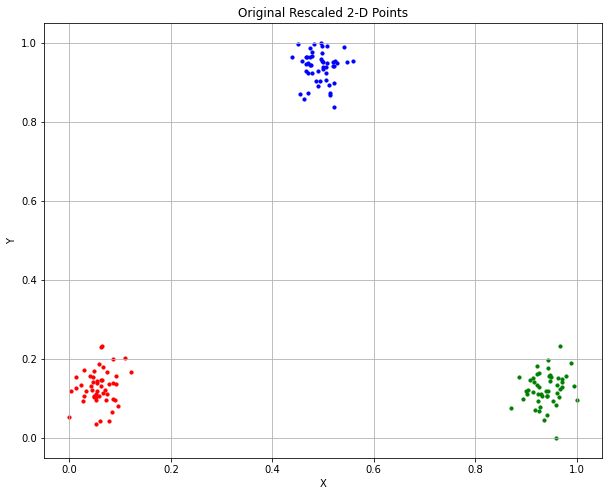

In [ ]:
vis = VisualizeScatter(fig_size=(10, 8), title="Original Rescaled 2-D Points")
vis.add_scatters(X)
vis.show_plot()

We can see three clusters of data points. 

**Let us use t-SNE to transform two-dimensional data points into one-dimensional data points.**

Let us use the [sklearn library](https://scikit-learn.org/stable/modules/generated/sklearn.manifold.TSNE.html) for it. 

Here, we have specified the `perplexity` hyperparameter. The chosen value is good for our dataset. We will discuss its significance later in the notebook. 

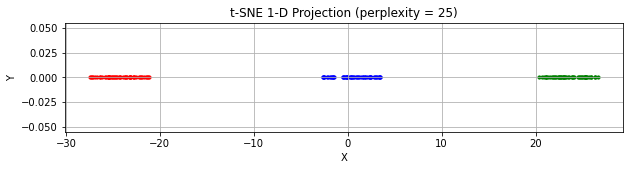

In [ ]:
perplexity = 25
X_embedded = TSNE(n_components=1, perplexity=perplexity, learning_rate='auto', 
                  init='random', random_state=seed).fit_transform(X)
tsne_vis = VisualizeScatter(fig_size=(10, 2), 
                            title='t-SNE 1-D Projection (perplexity = {})'.
                            format(perplexity))
tsne_vis.add_scatters(X_embedded)
tsne_vis.show_plot()

**We can see that one-dimensional projection preserves the three clusters.**

**Next, let us use PCA for one-dimensional projection.**

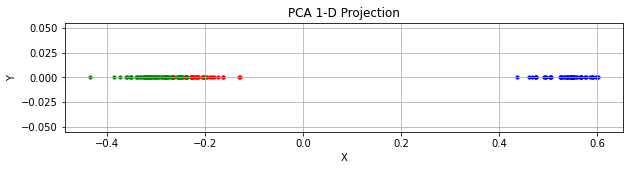

In [ ]:
pca = PCA(n_components=1)
X_reduced = pca.fit_transform(X)
pca_vis = VisualizeScatter(fig_size=(10, 2), title='PCA 1-D Projection')
pca_vis.add_scatters(X_reduced)
pca_vis.show_plot()

We can see that two clusters overlap with each other. It fails to preserve the relative positions. Anyway, PCA is meant to maximize variance and not maintain the relative position.

**Let us rerun the t-SNE with a smaller `perplexity` value.**

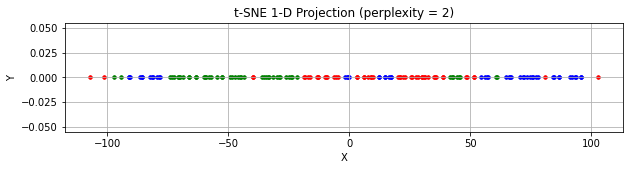

In [ ]:
perplexity = 2
X_embedded = TSNE(n_components=1, perplexity=perplexity, learning_rate='auto', 
                  init='random', random_state=seed).fit_transform(X)
tsne_vis = VisualizeScatter(fig_size=(10, 2), 
                            title='t-SNE 1-D Projection (perplexity = {})'.
                            format(perplexity))
tsne_vis.add_scatters(X_embedded)
tsne_vis.add_scatters(X_embedded)
tsne_vis.show_plot()

We can see that points from one cluster are mixed with others, and points are scattered all over for a very low `perplexity`. 

**Let us rerun the t-SNE with a larger `perplexity` value.**

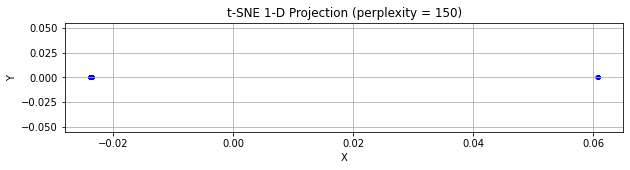

In [ ]:
perplexity = 150
X_embedded = TSNE(n_components=1, perplexity=perplexity, learning_rate='auto', 
                  init='random', random_state=seed).fit_transform(X)
tsne_vis = VisualizeScatter(fig_size=(10, 2), 
                            title='t-SNE 1-D Projection (perplexity = {})'.
                            format(perplexity))
tsne_vis.add_scatters(X_embedded)
tsne_vis.add_scatters(X_embedded)
tsne_vis.show_plot()

We can see that points from all clusters merged together into two clusters, and all points in the respective cluster are very close to each other for a very high `perplexity` (note that the total number of points is 150).

The description of perplexity in [SkLearn t-SNE API](https://scikit-learn.org/stable/modules/generated/sklearn.manifold.TSNE.html) is the following:

*The perplexity is related to the number of nearest neighbors that is used in other manifold learning algorithms. Larger datasets usually require a larger perplexity. Consider selecting a value between 5 and 50. Different values can result in significantly different results. The perplexity must be less that the number of samples.*

So when perplexity is very low, lower numbers of points are considered nearest neighbors, so other points are scattered, even those belonging to the same cluster.

And when perplexity is very high, higher numbers of points are considered the nearest neighbor, so almost all points are clubbed together. 

**There is an excellent explanation of ["How to use t-SNE effectively?"](https://distill.pub/2016/misread-tsne/).**


## Feature Visulaization using TensorBoard's t-SNE

Next, let us visualize high-dimensional CNN extracted features in two or three-dimensional feature maps.

Here, we will use a pre-trained model trained on the image-net dataset without fully connected layers (only CNN layers) as a feature extractor.

We will use TensorBoard Projector to map higher dimensional features to two or three-dimensional features.


We will use a subset of [Animal-10](https://www.kaggle.com/datasets/alessiocorrado99/animals10) dataset as sample data points. 

We have prepared the subset dataset; it has twenty images from every ten classes. 

Let us use the utility functions to download and unzip the dataset. 

In [ ]:
def download_file(url, save_name):
    """
    "Download and save the file."

    arguments:
    url (str): URL path of the file.
    save_name: (str): file path to save the downloaded file.
    """
    file = requests.get(url)
    open(save_name, 'wb').write(file.content)
    print(f"Downloaded {save_name}...")
    return

In [ ]:
def unzip(zip_file_path=None):
    """
    "Unzip the file"

    arguments:
    zip_file_path (str): The zipped file path

    """
    try:
        with ZipFile(zip_file_path) as z:
            z.extractall("./")
            print(f"Extracted {zip_file_path}...\n")
    except:
        print("Invalid file")

    return

In [ ]:
if not os.path.exists('animal10'):
    download_file(
                  'https://www.dropbox.com/sh/wyt8cvctpcvg10r/AAAuOf992j1vDf7S7oV1STW7a?dl=1', 
                  'animal10.zip'
                 )
    
    unzip('animal10.zip')

Downloaded animal10.zip...
Extracted animal10.zip...



Let us write a function to get all image paths for a given root directory. 


In [ ]:
def get_classwise_image_path(root_dir):
    image_paths = dict()
    classes = os.listdir(root_dir)
    for cls in classes:
        image_paths[cls] = []
        class_dir = os.path.join(root_dir, cls)
        images = os.listdir(class_dir)
        for image_name in images:
            img_path = os.path.join(class_dir, image_name)
            image_paths[cls].append(img_path)
    return image_paths


Use the above function to get all image paths.

In [ ]:
IMG_ROOT_DIR = 'animal10'
image_paths_dict = get_classwise_image_path(IMG_ROOT_DIR)

Let us define image width and height for the pre-trained model inference. 

In [ ]:
IMG_WIDTH, IMG_HEIGHT = (224, 224)

Let us write a function to read an image and resize it. We need this function to add images in TensorBoard. 


In [ ]:
def load_and_resize_image(img_path, width, height):
    img = Image.open(img_path).resize((width, height))
    return img

Before the model inference and use of t-SNE on extracted features, look into sample images from the Animal-10 dataset. 

Let us write a function for the same.


In [ ]:
def show_class_sample(image_path_dic, fig_size=(15, 6)):
    fig, axes = plt.subplots(
        nrows=2,
        ncols=5,
        figsize=fig_size
        )
    list_axes = list(axes.flat)
    classes = list(image_path_dic.keys())
    for i, ax in enumerate(list_axes): 
        img = load_and_resize_image(image_path_dic[classes[i]][0], IMG_WIDTH, 
                                    IMG_HEIGHT)
        ax.imshow(img)
        ax.xaxis.set_visible(False)
        ax.yaxis.set_visible(False)
        ax.set_title(classes[i])
    fig.suptitle("Animal-10 Dataset Samples", fontsize=15)
    plt.show()
    return

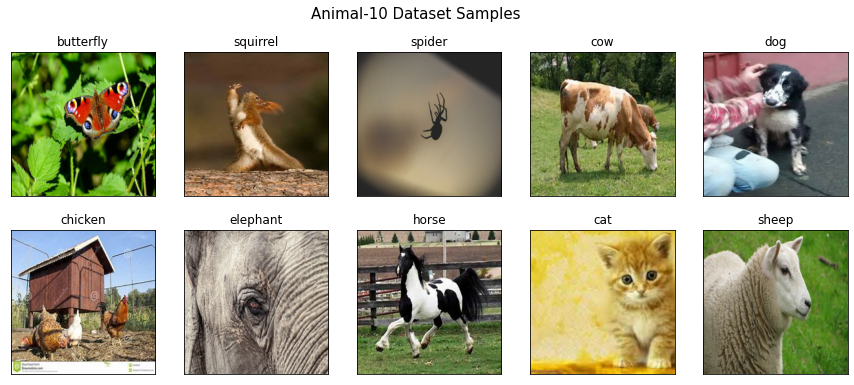

In [ ]:
show_class_sample(image_paths_dict)

Let us write a function to load a pre-trained model feature extractor trained on the image-net dataset. 

It takes image input size, model family, and model name. For example, for the model family `resnet50`, models are `ResNet50`, `ResNet50V2`, etc.

The model name is required to load the model, and the model family is needed to get preprocess function for the input image.

It returns a pre-trained CNN feature extractor and the preprocess function.


In [ ]:
def load_model_and_preprocess_func(input_shape, model_family, model_name):  
    
    # Models will be loaded wth pre-trainied `imagenet` weights.
    model = getattr(tf.keras.applications, model_name)(input_shape=input_shape, weights="imagenet", include_top=False)
    preprocess  = getattr(tf.keras.applications, model_family).preprocess_input
    return model, preprocess

The output shape of the CNN feature extractor is `batch_size`, `height`, `width`, `num_chanels`. However, to add these features to TensorBoard's Projector, we need to transfer it to a `1-D` tensor. To achieve it, we can use `GlobalAveragePooling2D` to take an average across `height` and `width`. For each image, it results in a `1-D` tensor of length equal to the number of channels. 

Let us write a function for it. It takes the CNN feature extractor, adds `GlobalAveragePooling2D` on top of it, and returns as Keras Model.


In [ ]:
def get_feature_extractor(model):
    inputs = model.inputs
    x = model(inputs)
    outputs = tf.keras.layers.GlobalAveragePooling2D()(x)
    feat_ext = tf.keras.Model(inputs=inputs, outputs=outputs, 
                              name="feature_extractor")
    return feat_ext

**Let us use the model and preprocess function.**

In [ ]:
IMAGE_SHAPE = (IMG_HEIGHT, IMG_WIDTH, 3)
MODEL_FAMILY = "resnet"
MODEL_NAME   = "ResNet101"
model, preprocess= load_model_and_preprocess_func(IMAGE_SHAPE, MODEL_FAMILY, 
                                                  MODEL_NAME)

171446536/171446536 [==============================] - 4s 0us/step


**Let us use the model to get the feature extractor.**

In [ ]:
feat_ext_model = get_feature_extractor(model)
print(feat_ext_model.summary())

Model: "feature_extractor"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 resnet101 (Functional)      (None, 7, 7, 2048)        42658176  
                                                                 
 global_average_pooling2d (G  (None, 2048)             0         
 lobalAveragePooling2D)                                          
                                                                 
Total params: 42,658,176
Trainable params: 42,552,832
Non-trainable params: 105,344
_________________________________________________________________
None


**Let us write a function that takes the input image, feature extractor (model), and preprocess function and returns the extracted feature.**

In [ ]:
def extract_features(input, model, preprocess):
    
    # Pre-process the input image.
    x = preprocess(input)

    # Generate predictions.
    preds = model.predict(x)

    return preds[0]

**Let us write a method to load and reshape the image that can be used for inference.**

In [ ]:
def load_image_for_inference(image_path, img_shape):
    
    # Load the image.
    image = tf.io.read_file(image_path)
    
    # Convert the image from bytes to an image tensor.
    x = tf.image.decode_image(image, channels=img_shape[2])
    
    # Resize image to the input shape required by the model.
    x = tf.image.resize(x, (img_shape[0], img_shape[1]))
    
    # Add a dimension for an image batch representation.
    x = tf.expand_dims(x, axis=0)

    return x

**Let us write a function that takes all image paths, the feature extractor model, and the preprocess function and returns resized images, labels, and `1-D` features.** 

In [ ]:
def get_images_labels_features(image_paths_dict, feature_extractor, preprocess):
    images = []
    labels = []
    features = []

    for cls in image_paths_dict:
        image_paths = image_paths_dict[cls]
        for img_path in image_paths:
            labels.append(cls)
            img = load_and_resize_image(img_path, IMG_WIDTH, IMG_HEIGHT)
            images.append(img)
            img_for_infer = load_image_for_inference(img_path, IMAGE_SHAPE)
            feature = extract_features(img_for_infer, feature_extractor, 
                                       preprocess)
            features.append(feature)
    return images, labels, features

**Let us get images, labels, and features using the above function.**

In [ ]:
images, labels, features = get_images_labels_features(image_paths_dict, feat_ext_model, preprocess)

1/1 [==============================] - 0s 29ms/step


Suppose we are interested in visualizing images in `2-D` or `3-D` space instead of points in TensorBoard. In that case, we need to add a sprite image (collection of images put into a single image) in TensorBoard's Projector. 

So let us write a function to create a sprite image. 

In [ ]:
def create_sprite_image(pil_images, save_path):
    # Assuming all images have the same width and height
    img_width, img_height = pil_images[0].size

    # create a master square images
    row_coln_count = int(np.ceil(np.sqrt(len(pil_images))))
    master_img_width = img_width * row_coln_count
    master_img_height = img_height * row_coln_count

    master_image = Image.new(
        mode = 'RGBA',
        size = (master_img_width, master_img_height),
        color = (0, 0, 0, 0)
    )

    for i, img in enumerate(pil_images):
        div, mod = divmod(i, row_coln_count)
        w_loc = img_width * mod
        h_loc = img_height * div
        master_image.paste(img, (w_loc, h_loc))

    master_image.convert('RGB').save(save_path, transparency=0)
    return


At this point, we have all feature vectors, their labels, and corresponding images. The sprite image can be created using these images. 

We have to add all this to TensorBoard and update TensorBorad's Projector config to visualize in TensorBoard. 

Let us write a function that takes the log directory path, images, features, and labels, adds it to TensorBoard, and updates Projector's config. 

It writes three files in the log directory:
- `metadata.tsv`: It has label information.
- `features.tsv`: It has feature vector information.
- `sprite.jpg`: It has image information.

Additionally, it writes a configuration file `projector_config.pbtxt`.

Below is a sample configuration file: 

```
embeddings {
  metadata_path: "metadata.tsv"
  sprite {
    image_path: "sprite.jpg"
    single_image_dim: 224
    single_image_dim: 224
  }
  tensor_path: "features.tsv"
}
```

In [ ]:
def write_embedding(log_dir, pil_images, features, labels):
    """Writes embedding data and projector configuration to the logdir."""
    metadata_filename = "metadata.tsv"
    tensor_filename = "features.tsv"
    sprite_image_filename = "sprite.jpg"


    os.makedirs(log_dir, exist_ok=True)
    with open(os.path.join(log_dir, metadata_filename), "w") as f:
        for label in labels:
            f.write("{}\n".format(label))
    with open(os.path.join(log_dir, tensor_filename), "w") as f:
        for tensor in features:
            f.write("{}\n".format("\t".join(str(x) for x in tensor)))

    sprite_image_path = os.path.join(log_dir, sprite_image_filename)

    config = projector.ProjectorConfig()
    embedding = config.embeddings.add()
    # Label info
    embedding.metadata_path = metadata_filename
    # Features info
    embedding.tensor_path = tensor_filename
    # Image info
    create_sprite_image(pil_images, sprite_image_path)
    embedding.sprite.image_path = sprite_image_filename
    # Specify the width and height of a single thumbnail.
    img_width, img_height = pil_images[0].size
    embedding.sprite.single_image_dim.extend([img_width, img_height])
    # Create the configuration file
    projector.visualize_embeddings(log_dir, config)
    
    return

**Let us use the above function to write embedding in the log directory.**

In [ ]:
LOG_DIR = os.path.join('logs', MODEL_NAME)
write_embedding(LOG_DIR, images, features, labels)

**Finally, let us visualize it using TensorBoard.**

In [ ]:
# %load_ext tensorboard
%reload_ext tensorboard

%tensorboard --logdir {LOG_DIR}

Reusing TensorBoard on port 6006 (pid 3257), started 0:01:02 ago. (Use '!kill 3257' to kill it.)

<IPython.core.display.Javascript object>

Note that the default selection of TensorBoard will be PCA. We have to click on T-SNE to use t-SNE visualization.

Play with different t-SNE hyperparameters, e.g., perplexity, learning rate, etc.

## References

- [How to Use t-SNE Effectively](https://distill.pub/2016/misread-tsne/)
- [t-SNE Learnopencv Blog](https://learnopencv.com/t-sne-for-feature-visualization/)
- [SK Learn t-SNE Library](https://scikit-learn.org/stable/modules/generated/sklearn.manifold.TSNE.html)
- [t-SNE Wikipidea](https://en.wikipedia.org/wiki/T-distributed_stochastic_neighbor_embedding)
- [TensorBoard Projector Plugin](https://www.tensorflow.org/tensorboard/tensorboard_projector_plugin)
- [TebsorBoard projector_demo.py](https://github.com/tensorflow/tensorboard/blob/master/tensorboard/plugins/projector/projector_demo.py)